## Imports:

In [1]:
import scipy.io
import os
import pandas
import numpy as np
import matplotlib.pyplot as plt

import matplotlib.pylab as plt_lab
import matplotlib.gridspec as gridspec
import obspy
import pandas as pd

RuntimeError: module compiled against API version 0xe but this version of numpy is 0xd

## Load data:
We are going to use this data to plot spectograms of SCG signals. 

In [2]:
dir_path = "/Users/ecem/Documents/GitHub/seismocardiogram/data/diseased-dataset"

In [3]:
x = np.load(dir_path + "/tr_x.npy", allow_pickle= True)
y = np.load(dir_path + "/tr_z.npy", allow_pickle= True)
z = np.load(dir_path + "/tr_y.npy", allow_pickle= True)

## Load csv and create two seperate dataframe:
We are going to use heart dataframe to differentiate healty people from the people with diaseaes. Data's of healty people will be stored in the healty dataset while diseased people will be in diseased dataset.

In [4]:
heart = pd.read_excel("/Users/ecem/Documents/GitHub/seismocardiogram/data/diseased-dataset/Summary_Pub_Deidentified.xlsx")
df = heart.copy().fillna(0)

I have dropped some columns because they didnt have much information. ????????

In [5]:
df.drop(["Mitral valve Peak velocity (m/sec)",
         "Mitral valve Mean gradient(mmHg)", 
         "Echo available",
        "Date of collection",
        "Date of echo"], 
        inplace = True, axis = 1)
df.drop(df.tail(1).index,inplace=True)

With this line of code we get indexes of healty people in the original(heart) dataset.

In [6]:
idx = np.where((df['History of MI'] == 0.0)  & (df['History of CABG'] == 0.0)  & (df['History of PCI'] == 0.0))

In [7]:
idx

(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
        17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 28, 29, 31, 32, 33, 34, 35,
        36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52,
        53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 68, 69, 91, 92,
        93, 94, 96, 97, 98]),)

We've created a new dataset(healty) by using indexes we have extracted earlier.

In [8]:
healty = df.loc[idx]

In [9]:
#preview
healty.head(5)

,Patient ID,Start,Duration,Sampling rate(Hz),Age,Gender,Height (cm),Weight (kg),History of MI,History of CABG,...,TAPSE,Aortic valve area (cm2),Aortic valve area Mean gradient(mmHg),Aortic valve area Peak velocity (m/sec),Mitral valve area (cm2),Moderate or greater MS,Moderate or greater MR,Moderate or greater AR,Moderate or greater AS,moderate or greater TR
0,CP-01,00:00:08,00:07:42,256.0,59.0,M,174.0,74.0,0.0,0.0,...,19.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0
1,CP-02,00:00:45,00:08:20,256.0,73.0,M,162.0,63.0,0.0,0.0,...,19.0,0.0,65.0,4.9,1.4,1.0,1.0,1.0,1.0,0.0
2,CP-03,00:00:40,00:08:50,256.0,70.0,M,167.0,84.0,0.0,0.0,...,20.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0
3,CP-04,00:00:02,00:08:30,256.0,56.0,M,154.0,56.0,0.0,0.0,...,17.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0
4,CP-05,00:00:50,00:07:00,256.0,59.0,M,163.0,55.0,0.0,0.0,...,17.0,1.0,74.0,4.3,0.0,0.0,0.0,1.0,1.0,0.0


Again using the indexes we've created a dataset to store diseased patients data. 

In [10]:
diseased = df.drop(idx[0], axis = 0)

In [11]:
#preview
diseased.head(5)

,Patient ID,Start,Duration,Sampling rate(Hz),Age,Gender,Height (cm),Weight (kg),History of MI,History of CABG,...,TAPSE,Aortic valve area (cm2),Aortic valve area Mean gradient(mmHg),Aortic valve area Peak velocity (m/sec),Mitral valve area (cm2),Moderate or greater MS,Moderate or greater MR,Moderate or greater AR,Moderate or greater AS,moderate or greater TR
27,CP-28,00:00:21,00:07:51,256.0,74.0,F,150.0,64.0,0.0,0.0,...,19.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0
30,CP-31,00:00:30,00:08:45,256.0,67.0,M,168.0,65.0,1.0,0.0,...,15.0,0.0,53.0,4.2,0.0,0.0,1.0,1.0,1.0,1.0
66,CP-67,00:00:33,00:06:49,256.0,66.0,F,150.0,73.0,1.0,0.0,...,13.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0
67,CP-68,00:00:29,00:05:31,256.0,65.0,M,170.0,62.0,1.0,0.0,...,12.0,0.0,0.0,0.0,0.8,1.0,0.0,0.0,0.0,1.0
70,UP-01,00:00:00,00:06:08,256.0,89.0,M,154.9,49.0,0.0,1.0,...,0.0,0.7,54.8,5.0,0.0,0.0,0.0,0.0,1.0,1.0


In [12]:
len(healty['Patient ID'].index)

73

In [13]:
len(diseased['Patient ID'].index)

27

To plot spectrogram we need array values of those patients. So we need to divide the x,y,z arrays into two subgroups for healty and diseased patients.

These empty list will be used to store array values.

In [14]:
healty_x_slice, healty_y_slice, healty_z_slice = [],[],[]

In [15]:
diseased_x_slice, diseased_y_slice, diseased_z_slice = [],[],[]

In [16]:
for i in range(len(healty['Patient ID'].index)):
    healty_x = x[healty['Patient ID'].index[i]]
    healty_y = y[healty['Patient ID'].index[i]]
    healty_z = z[healty['Patient ID'].index[i]]
    
    healty_x.stats.sampling_rate = healty.loc[healty['Patient ID'].index[i], 'Sampling rate(Hz)']
    healty_x_slice.append(healty_x)
    
    healty_y.stats.sampling_rate = healty.loc[healty['Patient ID'].index[i], 'Sampling rate(Hz)']
    healty_y_slice.append(healty_y) 

    healty_z.stats.sampling_rate = healty.loc[healty['Patient ID'].index[i], 'Sampling rate(Hz)']
    healty_z_slice.append(healty_z) 

In [17]:
for i in range(len(diseased['Patient ID'].index)):
    diseased_x = x[diseased['Patient ID'].index[i]]
    diseased_y = y[diseased['Patient ID'].index[i]]
    diseased_z = z[diseased['Patient ID'].index[i]]
    
    diseased_x.stats.sampling_rate = healty.loc[healty['Patient ID'].index[i], 'Sampling rate(Hz)']
    diseased_x_slice.append(diseased_x)
    
    diseased_y.stats.sampling_rate = healty.loc[healty['Patient ID'].index[i], 'Sampling rate(Hz)']
    diseased_y_slice.append(diseased_y)
    
    diseased_z.stats.sampling_rate = healty.loc[healty['Patient ID'].index[i], 'Sampling rate(Hz)']
    diseased_z_slice.append(diseased_z)

In [18]:
healty_x_slice[71].stats.sampling_rate

512.25

In [19]:
diseased_x_slice[21].stats.sampling_rate

256.0

## comparison of two dataset:

Now we will to try visualize spectograms. So far we have used Obspy to visualize SCG signals. However, with obspy we are not able to plot spectograms side by side. This is important for us because we want to see spectograms of x,y and z components simultaneously for both healty and diseased people. So, from now on I will refer to those plots, for 3 components of healty and diseased (in total six plot, as "PAIR".


I have mentioned that Obpsy has a problem in side by side plotting. So I changed it source code. I have added and deleted some part to operate according to my need. ???????????

Thats why from now on we are going to use **output_spectogram** function to get values needed to plot spectogram.

These are the imports for output_spectogram function to work.

In [20]:
from obspy.imaging.cm import obspy_sequential
import math
from matplotlib import mlab
from matplotlib.colors import Normalize

In [21]:
def _nearest_pow_2(x):
    a = math.pow(2, math.ceil(np.log2(x)))
    b = math.pow(2, math.floor(np.log2(x)))
    if abs(a - x) < abs(b - x):
        return a
    else:
        return b

In [22]:
def output_spectrogram(data, samp_rate, per_lap=0.9, wlen=None, log=False,
                outfile=None, fmt=None, axes=None, dbscale=False,
                mult=8.0, cmap=obspy_sequential, zorder=None, title=None,
                show=True, clip=[0.0, 1.0]):
 
    import matplotlib.pyplot as plt
    
    # enforce float for samp_rate
    samp_rate = float(samp_rate)

    # set wlen from samp_rate if not specified otherwise
    if not wlen:
        wlen = samp_rate / 100.

    npts = len(data)
    # nfft needs to be an integer, otherwise a deprecation will be raised
    # XXX add condition for too many windows => calculation takes for ever
    nfft = int(_nearest_pow_2(wlen * samp_rate))
    if nfft > npts:
        nfft = int(_nearest_pow_2(npts / 8.0))

    if mult is not None:
        mult = int(_nearest_pow_2(mult))
        mult = mult * nfft
    nlap = int(nfft * float(per_lap))

    data = data - data.mean()
    end = npts / samp_rate

    # Here we call not plt.specgram as this already produces a plot
    # matplotlib.mlab.specgram should be faster as it computes only the
    # arrays
    # XXX mlab.specgram uses fft, would be better and faster use rfft
    specgram, freq, time = mlab.specgram(data, Fs=samp_rate, NFFT=nfft,
                                         pad_to=mult, noverlap=nlap)
    # db scale and remove zero/offset for amplitude
    if dbscale:
        specgram = 10 * np.log10(specgram[1:, :])
    else:
        specgram = np.sqrt(specgram[1:, :])
    freq = freq[1:]
    
    vmin, vmax = clip
    if vmin < 0 or vmax > 1 or vmin >= vmax:
        msg = "Invalid parameters for clip option."
        raise ValueError(msg)
    _range = float(specgram.max() - specgram.min())
    vmin = specgram.min() + vmin * _range
    vmax = specgram.min() + vmax * _range
    norm = Normalize(vmin, vmax, clip=True)

    # calculate half bin width
    halfbin_time = (time[1] - time[0]) / 2.0
    halfbin_freq = (freq[1] - freq[0]) / 2.0

    # argument None is not allowed for kwargs on matplotlib python 3.3
    kwargs = {k: v for k, v in (('cmap', cmap), ('zorder', zorder))
              if v is not None}

    if log:
        # pcolor expects one bin more at the right end
        freq = np.concatenate((freq, [freq[-1] + 2 * halfbin_freq]))
        time = np.concatenate((time, [time[-1] + 2 * halfbin_time]))
        # center bin
        time -= halfbin_time
        freq -= halfbin_freq
        # Log scaling for frequency values (y-axis)
        ax.set_yscale('log')
        # Plot times
        ax.pcolormesh(time, freq, specgram, norm=norm, **kwargs)
    else:
        # this method is much much faster!
        specgram = np.flipud(specgram)
        # center bin
        extent = (time[0] - halfbin_time, time[-1] + halfbin_time,
                  freq[0] - halfbin_freq, freq[-1] + halfbin_freq)
    return [specgram, extent, end]

    



### sanity check

Here, we see two spectogram of the same data. First from my function while the second is from obspy. We see that they are the same.

In [23]:
spectogram = output_spectrogram(x[0].data, x[0].stats.sampling_rate, wlen=10)[0]
extent = output_spectrogram(x[0].data, x[0].stats.sampling_rate, wlen=10)[1]
end = output_spectrogram(x[0].data, x[0].stats.sampling_rate, wlen=10)[2]

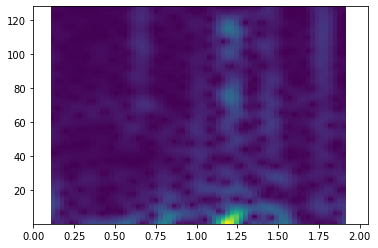

In [24]:
fig = plt.figure()
ax = fig.add_subplot(111)
ax.imshow(spectogram, interpolation="nearest", extent=extent)
ax.axis('tight')
ax.set_xlim(0, end)
ax.grid(False)

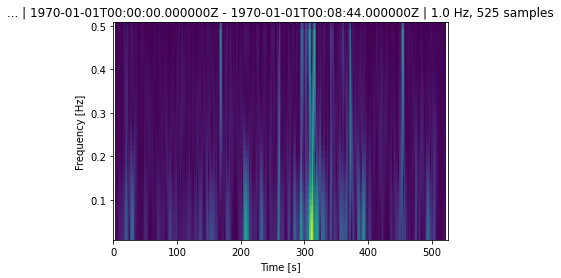

In [25]:
 obspy.core.trace.Trace(np.array(x[0])).spectrogram(wlen=10)

## Plotting spectogram with my altered output_spectogram function:

We saw that healty dataset contains 73 unique data while diseased dataset contains 27. So we can't plot all spectograms in a one to one uniquness. 

* The first part will plot all 27 SCG data which belongs to diseased patients.
* The second part will plot all 73 SCG data which belongs to healty patients.
* The third part will allow you to plot only a pair. 
* The fourth part will allow you to plot pair with specified number.

### 1- plots of spectograms for all SCG's in Diseased dataset:
since diseased dataset has 27 unique elements below illustration will only plot 27 plots for each. There will be no duplications.

/var/folders/gd/3d6ckpdn4q30skhxnvs_p7b80000gn/T/ipykernel_96874/2239154067.py:15: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(18,4))


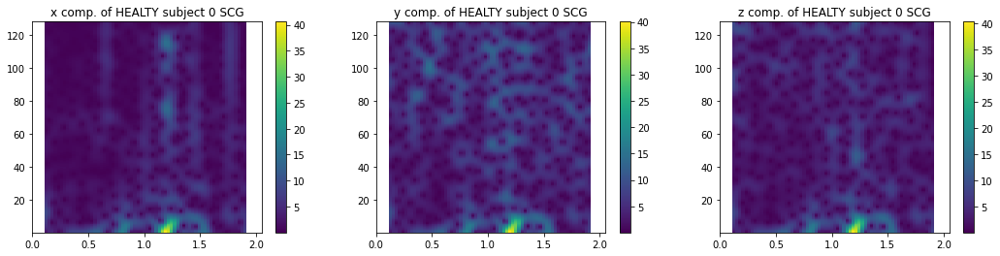

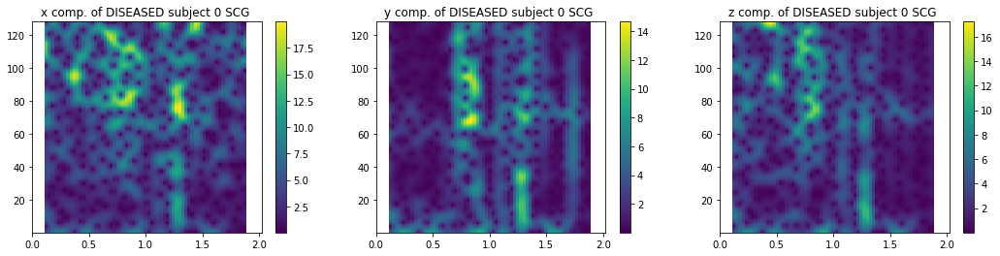

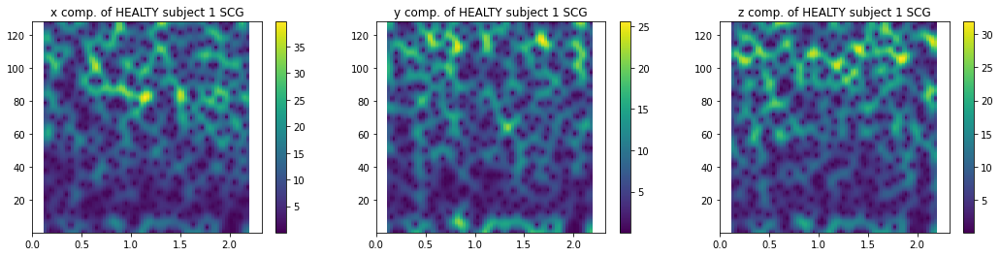

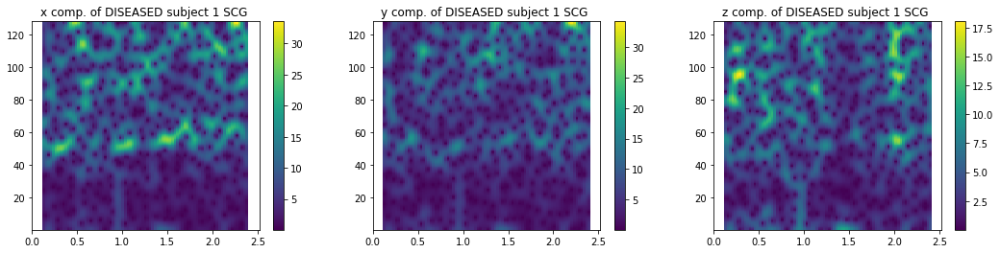

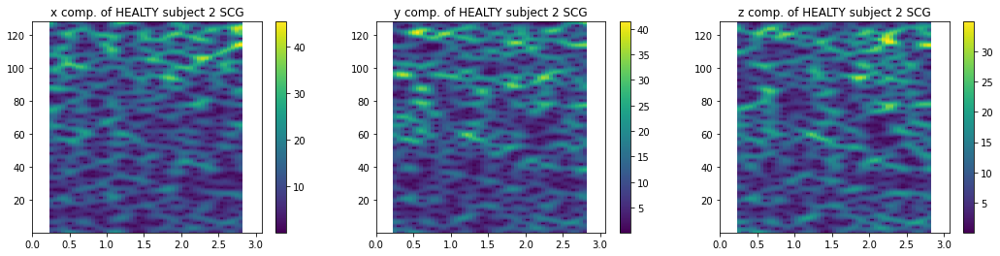

...

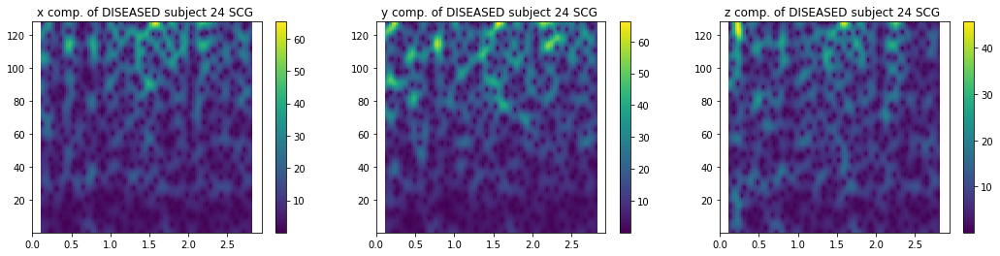

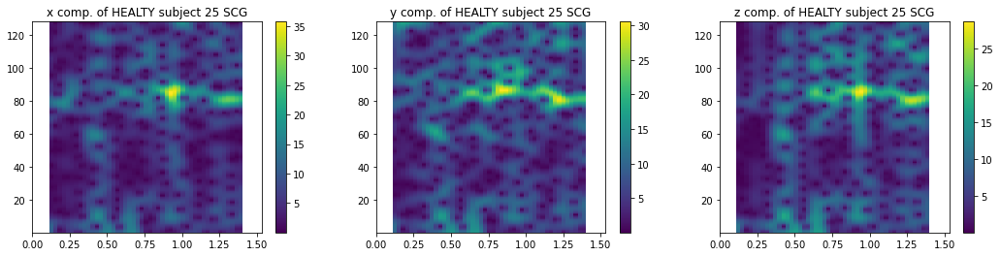

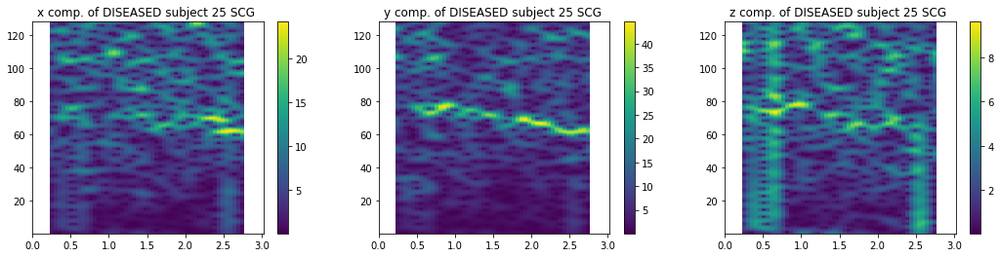

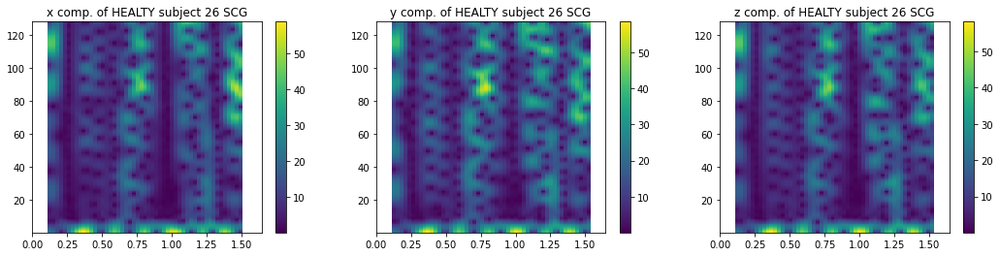

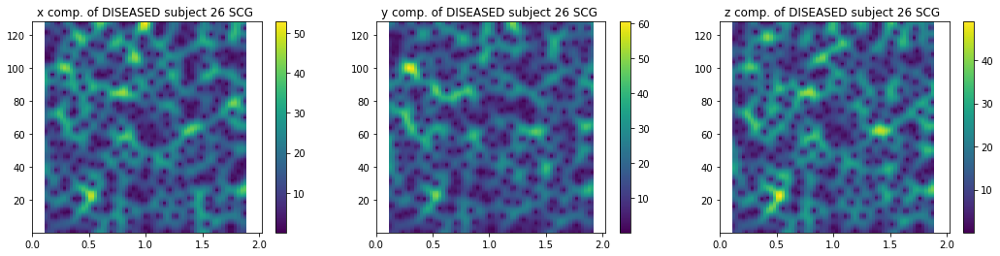

In [27]:
for i in range(len(healty['Patient ID'].index)):
    if i < 27:
        h_s_x = output_spectrogram(healty_x_slice[i].data, healty_x_slice[i].stats.sampling_rate, wlen=10)[0]
        h_e_x = output_spectrogram(healty_x_slice[i].data, healty_x_slice[i].stats.sampling_rate, wlen=10)[1]
        h_end_x = output_spectrogram(healty_x_slice[i].data, healty_x_slice[i].stats.sampling_rate, wlen=10)[2]

        h_s_y = output_spectrogram(healty_y_slice[i].data, healty_y_slice[i].stats.sampling_rate, wlen=10)[0]
        h_e_y = output_spectrogram(healty_y_slice[i].data, healty_y_slice[i].stats.sampling_rate, wlen=10)[1]
        h_end_y = output_spectrogram(healty_y_slice[i].data, healty_y_slice[i].stats.sampling_rate, wlen=10)[2]
        
        h_s_z = output_spectrogram(healty_z_slice[i].data, healty_z_slice[i].stats.sampling_rate, wlen=10)[0]
        h_e_z = output_spectrogram(healty_z_slice[i].data, healty_z_slice[i].stats.sampling_rate, wlen=10)[1]
        h_end_z = output_spectrogram(healty_z_slice[i].data, healty_z_slice[i].stats.sampling_rate, wlen=10)[2]
        
        fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(18,4))

        ax1.imshow(h_s_x, interpolation="nearest", extent=h_e_x)
        ax1.axis('tight')
        ax1.set_xlim(0, h_end_x)
        ax1.title.set_text('x comp. of HEALTY subject {} SCG'.format(i))
        ax1.grid(False)
        fig.colorbar(ax1.images[0], ax = ax1)
       
        
        ax2.imshow(h_s_y, interpolation="nearest", extent=h_e_y)
        ax2.axis('tight')
        ax2.set_xlim(0, h_end_y)
        ax2.title.set_text('y comp. of HEALTY subject {} SCG'.format(i))
        ax2.grid(False)
        fig.colorbar(ax2.images[0], ax = ax2)
        
        ax3.imshow(h_s_z, interpolation="nearest", extent=h_e_z)
        ax3.axis('tight')
        ax3.set_xlim(0, h_end_z)
        ax3.title.set_text('z comp. of HEALTY subject {} SCG'.format(i))
        ax3.grid(False)
        fig.colorbar(ax3.images[0], ax = ax3)
        
        
        d_s_x = output_spectrogram(diseased_x_slice[i].data, diseased_x_slice[i].stats.sampling_rate, wlen=10)[0]
        d_e_x = output_spectrogram(diseased_x_slice[i].data, diseased_x_slice[i].stats.sampling_rate, wlen=10)[1]
        d_end_x = output_spectrogram(diseased_x_slice[i].data, diseased_x_slice[i].stats.sampling_rate, wlen=10)[2]
        
        d_s_y = output_spectrogram(diseased_y_slice[i].data, diseased_y_slice[i].stats.sampling_rate, wlen=10)[0]
        d_e_y = output_spectrogram(diseased_y_slice[i].data, diseased_y_slice[i].stats.sampling_rate, wlen=10)[1]
        d_end_y = output_spectrogram(diseased_y_slice[i].data, diseased_y_slice[i].stats.sampling_rate, wlen=10)[2]
        
        d_s_z = output_spectrogram(diseased_z_slice[i].data, diseased_z_slice[i].stats.sampling_rate, wlen=10)[0]
        d_e_z = output_spectrogram(diseased_z_slice[i].data, diseased_z_slice[i].stats.sampling_rate, wlen=10)[1]
        d_end_z = output_spectrogram(diseased_z_slice[i].data, diseased_z_slice[i].stats.sampling_rate, wlen=10)[2]
        
        
        fig, (ax4, ax5, ax6) = plt.subplots(1, 3,  figsize=(18,4))

        ax4.imshow(d_s_x, interpolation="nearest", extent=d_e_x)
        ax4.axis('tight')
        ax4.set_xlim(0, d_end_x)
        ax4.title.set_text('x comp. of DISEASED subject {} SCG '.format(i))
        ax4.grid(False)
        fig.colorbar(ax4.images[0], ax = ax4)
        
        ax5.imshow(d_s_y, interpolation="nearest", extent=d_e_y)
        ax5.axis('tight')
        ax5.set_xlim(0, d_end_y)
        ax5.title.set_text('y comp. of DISEASED subject {} SCG '.format(i))
        ax5.grid(False)
        fig.colorbar(ax5.images[0], ax = ax5)
    
        ax6.imshow(d_s_z, interpolation="nearest", extent=d_e_z)
        ax6.axis('tight')
        ax6.set_xlim(0, d_end_z)
        ax6.title.set_text('z comp. of DISEASED subject {} SCG '.format(i))
        ax6.grid(False)
        fig.colorbar(ax6.images[0], ax = ax6)


### 2- plots of spectograms for all SCG's in Healty dataset:
Now, since we have 73 unique elements in healty dataset below illustration will show all 73 healty patients spectograms. However this time there will be duplicates of diseased dataset since it contains only 27 unique elements.

/var/folders/gd/3d6ckpdn4q30skhxnvs_p7b80000gn/T/ipykernel_92971/1283802200.py:15: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(18,4))


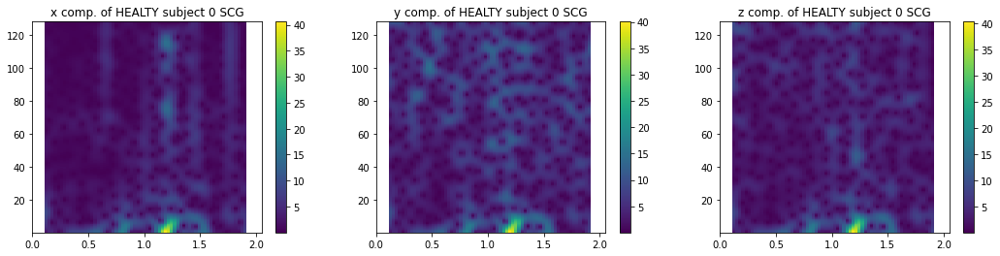

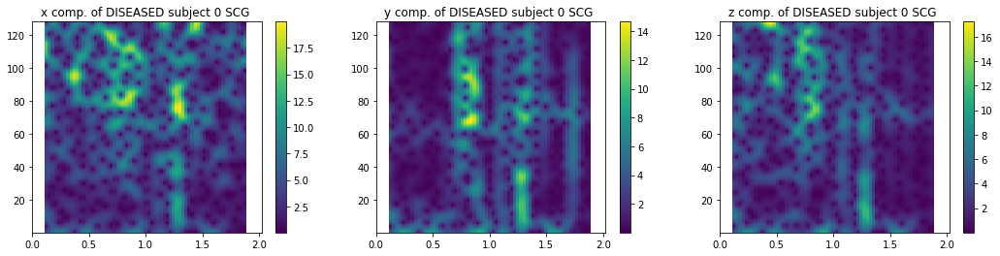

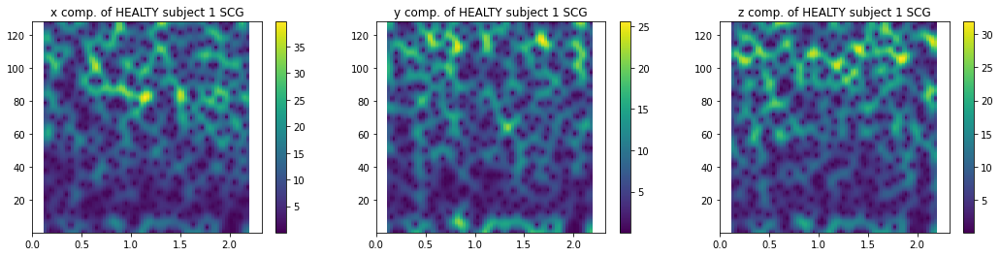

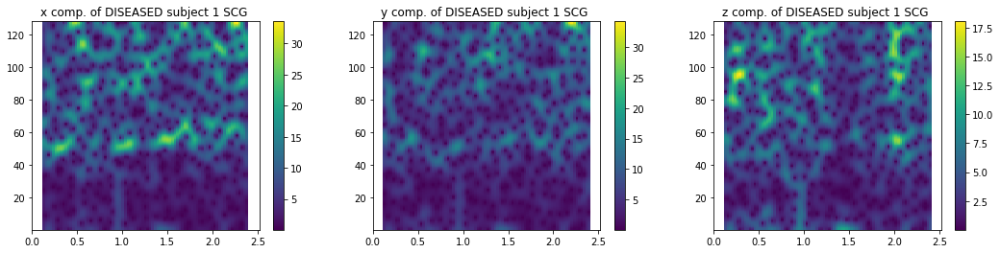

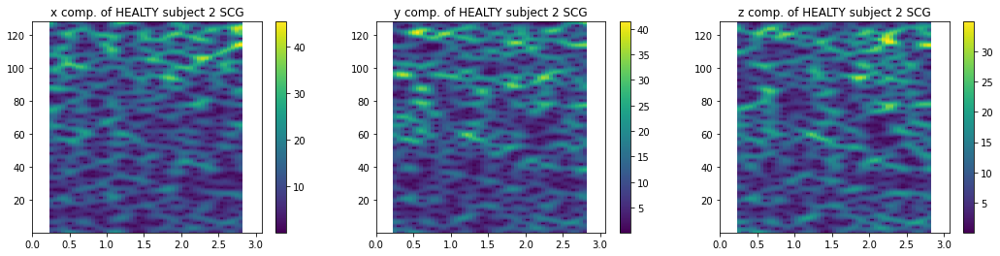

...

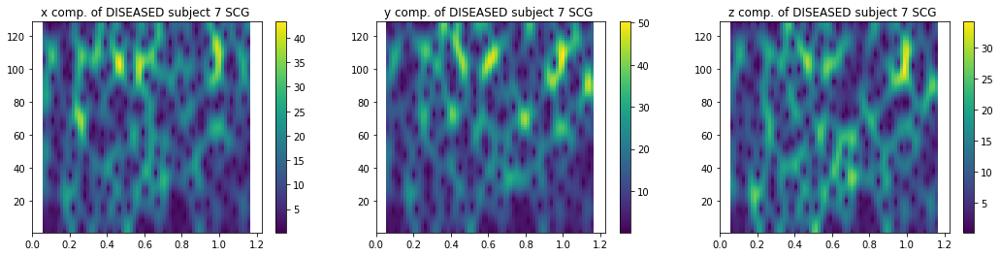

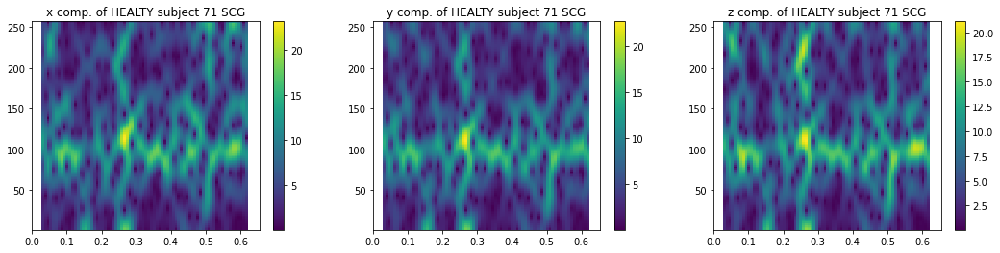

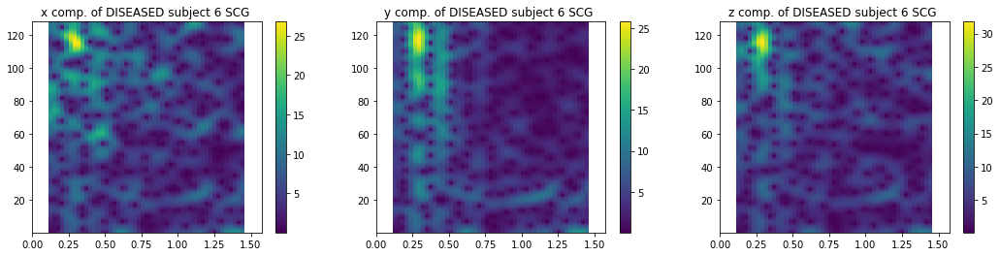

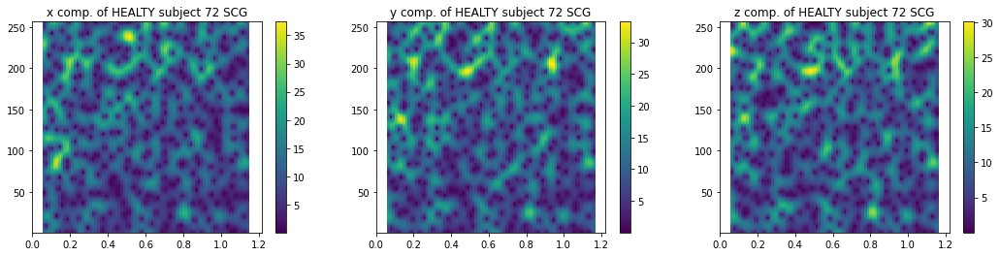

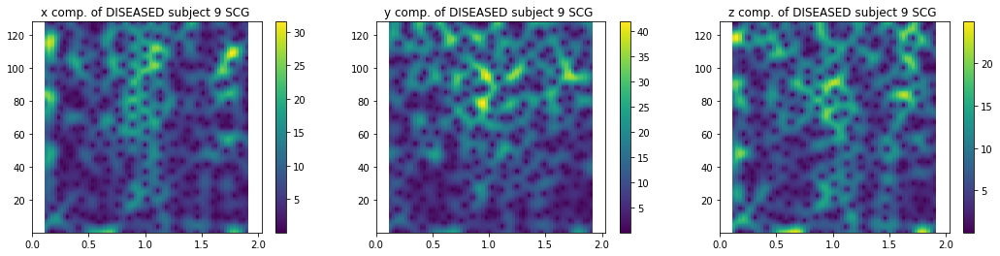

In [28]:
for i in range(len(healty['Patient ID'].index)):
    if i < 27:
        h_s_x = output_spectrogram(healty_x_slice[i].data, healty_x_slice[i].stats.sampling_rate, wlen=10)[0]
        h_e_x = output_spectrogram(healty_x_slice[i].data, healty_x_slice[i].stats.sampling_rate, wlen=10)[1]
        h_end_x = output_spectrogram(healty_x_slice[i].data, healty_x_slice[i].stats.sampling_rate, wlen=10)[2]

        h_s_y = output_spectrogram(healty_y_slice[i].data, healty_y_slice[i].stats.sampling_rate, wlen=10)[0]
        h_e_y = output_spectrogram(healty_y_slice[i].data, healty_y_slice[i].stats.sampling_rate, wlen=10)[1]
        h_end_y = output_spectrogram(healty_y_slice[i].data, healty_y_slice[i].stats.sampling_rate, wlen=10)[2]
        
        h_s_z = output_spectrogram(healty_z_slice[i].data, healty_z_slice[i].stats.sampling_rate, wlen=10)[0]
        h_e_z = output_spectrogram(healty_z_slice[i].data, healty_z_slice[i].stats.sampling_rate, wlen=10)[1]
        h_end_z = output_spectrogram(healty_z_slice[i].data, healty_z_slice[i].stats.sampling_rate, wlen=10)[2]
        
        fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(18,4))

        ax1.imshow(h_s_x, interpolation="nearest", extent=h_e_x)
        ax1.axis('tight')
        ax1.set_xlim(0, h_end_x)
        ax1.title.set_text('x comp. of HEALTY subject {} SCG'.format(i))
        ax1.grid(False)
        fig.colorbar(ax1.images[0], ax = ax1)
        
        ax2.imshow(h_s_y, interpolation="nearest", extent=h_e_y)
        ax2.axis('tight')
        ax2.set_xlim(0, h_end_y)
        ax2.title.set_text('y comp. of HEALTY subject {} SCG'.format(i))
        ax2.grid(False)
        fig.colorbar(ax2.images[0], ax = ax2)
        
        ax3.imshow(h_s_z, interpolation="nearest", extent=h_e_z)
        ax3.axis('tight')
        ax3.set_xlim(0, h_end_z)
        ax3.title.set_text('z comp. of HEALTY subject {} SCG'.format(i))
        ax3.grid(False)
        fig.colorbar(ax3.images[0], ax = ax3)
        
        
        d_s_x = output_spectrogram(diseased_x_slice[i].data, diseased_x_slice[i].stats.sampling_rate, wlen=10)[0]
        d_e_x = output_spectrogram(diseased_x_slice[i].data, diseased_x_slice[i].stats.sampling_rate, wlen=10)[1]
        d_end_x = output_spectrogram(diseased_x_slice[i].data, diseased_x_slice[i].stats.sampling_rate, wlen=10)[2]
        
        d_s_y = output_spectrogram(diseased_y_slice[i].data, diseased_y_slice[i].stats.sampling_rate, wlen=10)[0]
        d_e_y = output_spectrogram(diseased_y_slice[i].data, diseased_y_slice[i].stats.sampling_rate, wlen=10)[1]
        d_end_y = output_spectrogram(diseased_y_slice[i].data, diseased_y_slice[i].stats.sampling_rate, wlen=10)[2]
        
        d_s_z = output_spectrogram(diseased_z_slice[i].data, diseased_z_slice[i].stats.sampling_rate, wlen=10)[0]
        d_e_z = output_spectrogram(diseased_z_slice[i].data, diseased_z_slice[i].stats.sampling_rate, wlen=10)[1]
        d_end_z = output_spectrogram(diseased_z_slice[i].data, diseased_z_slice[i].stats.sampling_rate, wlen=10)[2]
        
        
        fig, (ax4, ax5, ax6) = plt.subplots(1, 3,  figsize=(18,4))

        ax4.imshow(d_s_x, interpolation="nearest", extent=d_e_x)
        ax4.axis('tight')
        ax4.set_xlim(0, d_end_x)
        ax4.title.set_text('x comp. of DISEASED subject {} SCG '.format(i))
        ax4.grid(False)
        fig.colorbar(ax4.images[0], ax = ax4)
        
        ax5.imshow(d_s_y, interpolation="nearest", extent=d_e_y)
        ax5.axis('tight')
        ax5.set_xlim(0, d_end_y)
        ax5.title.set_text('y comp. of DISEASED subject {} SCG '.format(i))
        ax5.grid(False)
        fig.colorbar(ax5.images[0], ax = ax5)
    
        ax6.imshow(d_s_z, interpolation="nearest", extent=d_e_z)
        ax6.axis('tight')
        ax6.set_xlim(0, d_end_z)
        ax6.title.set_text('z comp. of DISEASED subject {} SCG '.format(i))
        ax6.grid(False)
        fig.colorbar(ax6.images[0], ax = ax6)
        
    else:
        h_s_x = output_spectrogram(healty_x_slice[i].data, healty_x_slice[i].stats.sampling_rate, wlen=10)[0]
        h_e_x = output_spectrogram(healty_x_slice[i].data, healty_x_slice[i].stats.sampling_rate, wlen=10)[1]
        h_end_x = output_spectrogram(healty_x_slice[i].data, healty_x_slice[i].stats.sampling_rate, wlen=10)[2]

        h_s_y = output_spectrogram(healty_y_slice[i].data, healty_y_slice[i].stats.sampling_rate, wlen=10)[0]
        h_e_y = output_spectrogram(healty_y_slice[i].data, healty_y_slice[i].stats.sampling_rate, wlen=10)[1]
        h_end_y = output_spectrogram(healty_y_slice[i].data, healty_y_slice[i].stats.sampling_rate, wlen=10)[2]
        
        h_s_z = output_spectrogram(healty_z_slice[i].data, healty_z_slice[i].stats.sampling_rate, wlen=10)[0]
        h_e_z = output_spectrogram(healty_z_slice[i].data, healty_z_slice[i].stats.sampling_rate, wlen=10)[1]
        h_end_z = output_spectrogram(healty_z_slice[i].data, healty_z_slice[i].stats.sampling_rate, wlen=10)[2]
        
        fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(18,4))

        ax1.imshow(h_s_x, interpolation="nearest", extent=h_e_x)
        ax1.axis('tight')
        ax1.set_xlim(0, h_end_x)
        ax1.title.set_text('x comp. of HEALTY subject {} SCG'.format(i))
        ax1.grid(False)
        fig.colorbar(ax1.images[0], ax = ax1)
        
        ax2.imshow(h_s_y, interpolation="nearest", extent=h_e_y)
        ax2.axis('tight')
        ax2.set_xlim(0, h_end_y)
        ax2.title.set_text('y comp. of HEALTY subject {} SCG'.format(i))
        ax2.grid(False)
        fig.colorbar(ax2.images[0], ax = ax2)
        
        ax3.imshow(h_s_z, interpolation="nearest", extent=h_e_z)
        ax3.axis('tight')
        ax3.set_xlim(0, h_end_z)
        ax3.title.set_text('z comp. of HEALTY subject {} SCG'.format(i))
        ax3.grid(False)
        fig.colorbar(ax3.images[0], ax = ax3)
        
        j = np.random.randint(0,27)
            
        d_s_x = output_spectrogram(diseased_x_slice[j].data, diseased_x_slice[j].stats.sampling_rate, wlen=10)[0]
        d_e_x = output_spectrogram(diseased_x_slice[j].data, diseased_x_slice[j].stats.sampling_rate, wlen=10)[1]
        d_end_x = output_spectrogram(diseased_x_slice[j].data, diseased_x_slice[j].stats.sampling_rate, wlen=10)[2]
        
        d_s_y = output_spectrogram(diseased_y_slice[j].data, diseased_y_slice[j].stats.sampling_rate, wlen=10)[0]
        d_e_y = output_spectrogram(diseased_y_slice[j].data, diseased_y_slice[j].stats.sampling_rate, wlen=10)[1]
        d_end_y = output_spectrogram(diseased_y_slice[j].data, diseased_y_slice[j].stats.sampling_rate, wlen=10)[2]
        
        d_s_z = output_spectrogram(diseased_z_slice[j].data, diseased_z_slice[j].stats.sampling_rate, wlen=10)[0]
        d_e_z = output_spectrogram(diseased_z_slice[j].data, diseased_z_slice[j].stats.sampling_rate, wlen=10)[1]
        d_end_z = output_spectrogram(diseased_z_slice[j].data, diseased_z_slice[j].stats.sampling_rate, wlen=10)[2]
        
        
        fig, (ax4, ax5, ax6) = plt.subplots(1, 3,  figsize=(18,4))

        ax4.imshow(d_s_x, interpolation="nearest", extent=d_e_x)
        ax4.axis('tight')
        ax4.set_xlim(0, d_end_x)
        ax4.title.set_text('x comp. of DISEASED subject {} SCG '.format(j))
        ax4.grid(False)
        fig.colorbar(ax4.images[0], ax = ax4)
        
        ax5.imshow(d_s_y, interpolation="nearest", extent=d_e_y)
        ax5.axis('tight')
        ax5.set_xlim(0, d_end_y)
        ax5.title.set_text('y comp. of DISEASED subject {} SCG '.format(j))
        ax5.grid(False)
        fig.colorbar(ax5.images[0], ax = ax5)
    
        ax6.imshow(d_s_z, interpolation="nearest", extent=d_e_z)
        ax6.axis('tight')
        ax6.set_xlim(0, d_end_z)
        ax6.title.set_text('z comp. of DISEASED subject {} SCG '.format(j))
        ax6.grid(False)
        fig.colorbar(ax6.images[0], ax = ax6)
    


### 3- a pair of spectogram:
To plot only a pair of spectogram, I have written the **random_scg** function which takes two dataset and one seed value (use only if you want to get same plot at each run).

For the sake of code complexity, I stacked x, y and z into a dataset. With this our code will be understood more easily.


In [29]:
#stacking x, y, z values of healty dataset
dataset1 = np.stack((healty_x_slice, healty_y_slice, healty_z_slice), axis=-1)

/Users/ecem/miniforge3/envs/tf-metal/lib/python3.9/site-packages/numpy/core/_asarray.py:136: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray
  return array(a, dtype, copy=False, order=order, subok=True)


In [29]:
#stacking x, y, z values of diseased dataset
dataset2 = np.stack((diseased_x_slice, diseased_y_slice, diseased_z_slice), axis=-1)

In [30]:
def random_scg(dataset1, dataset2, seed = None):
    np.random.seed(seed)
    len_of_dt1 = len(dataset1)
    len_of_dt2 = len(dataset2)
    
    i = np.random.randint(0,len_of_dt1)
    j = np.random.randint(0,len_of_dt2)
    
    dt1_x = output_spectrogram(dataset1[i][0].data, dataset1[i][0].stats.sampling_rate, wlen=10)
    spectogram_x1, extent_x1, end_x1 = dt1_x[0], dt1_x[1], dt1_x[2]

    dt1_y = output_spectrogram(dataset1[i][1].data, dataset1[i][1].stats.sampling_rate, wlen=10)
    spectogram_y1, extent_y1, end_y1 = dt1_y[0], dt1_y[1], dt1_y[2]
    
    dt1_z = output_spectrogram(dataset1[i][2].data, dataset1[i][2].stats.sampling_rate, wlen=10)
    spectogram_z1, extent_z1, end_z1 = dt1_z[0], dt1_z[1], dt1_z[2]
    

    fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(18,4))

    ax1.imshow(spectogram_x1, interpolation="nearest", extent = extent_x1)
    ax1.axis('tight')
    ax1.set_xlim(0, end_x1)
    ax1.title.set_text('x comp. of HEALTY subject {} SCG'.format(i))
    ax1.grid(False)
    fig.colorbar(ax1.images[0], ax = ax1)
        
    ax2.imshow(spectogram_y1, interpolation="nearest", extent= extent_y1)
    ax2.axis('tight')
    ax2.set_xlim(0, end_y1)
    ax2.title.set_text('y comp. of HEALTY subject {} SCG'.format(i))
    ax2.grid(False)
    fig.colorbar(ax2.images[0], ax = ax2)
        
    ax3.imshow(spectogram_z1, interpolation="nearest", extent = extent_z1)
    ax3.axis('tight')
    ax3.set_xlim(0, end_z1)
    ax3.title.set_text('z comp. of HEALTY subject {} SCG'.format(i))
    ax3.grid(False)
    fig.colorbar(ax3.images[0], ax = ax3)
        
        
    dt2_x = output_spectrogram(dataset2[j][0].data, dataset2[j][0].stats.sampling_rate, wlen=10)
    spectogram_x2, extent_x2, end_x2 = dt2_x[0], dt2_x[1], dt2_x[2]

    dt2_y = output_spectrogram(dataset2[j][1].data, dataset2[j][1].stats.sampling_rate, wlen=10)
    spectogram_y2, extent_y2, end_y2 = dt2_y[0], dt2_y[1], dt2_y[2]
    
    dt2_z = output_spectrogram(dataset2[j][2].data, dataset2[j][2].stats.sampling_rate, wlen=10)
    spectogram_z2, extent_z2, end_z2 = dt2_z[0], dt2_z[1], dt2_z[2]
    
        
    fig, (ax4, ax5, ax6) = plt.subplots(1, 3,  figsize=(18,4))

    ax4.imshow(spectogram_x2, interpolation="nearest", extent= extent_x2)
    ax4.axis('tight')
    ax4.set_xlim(0, end_x2)
    ax4.title.set_text('x comp. of DISEASED subject {} SCG '.format(j))
    ax4.grid(False)
    fig.colorbar(ax4.images[0], ax = ax4)
        
    ax5.imshow(spectogram_y2, interpolation="nearest", extent= extent_y2)
    ax5.axis('tight')
    ax5.set_xlim(0, end_y2)
    ax5.title.set_text('y comp. of DISEASED subject {} SCG '.format(j))
    ax5.grid(False)
    fig.colorbar(ax5.images[0], ax = ax5)
    
    ax6.imshow(spectogram_z2, interpolation="nearest", extent= extent_z2)
    ax6.axis('tight')
    ax6.set_xlim(0, end_z2)
    ax6.title.set_text('z comp. of DISEASED subject {} SCG '.format(j))
    ax6.grid(False)
    fig.colorbar(ax6.images[0], ax = ax6)


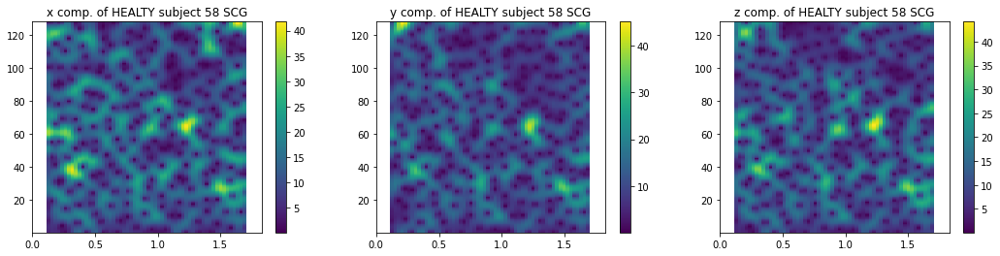

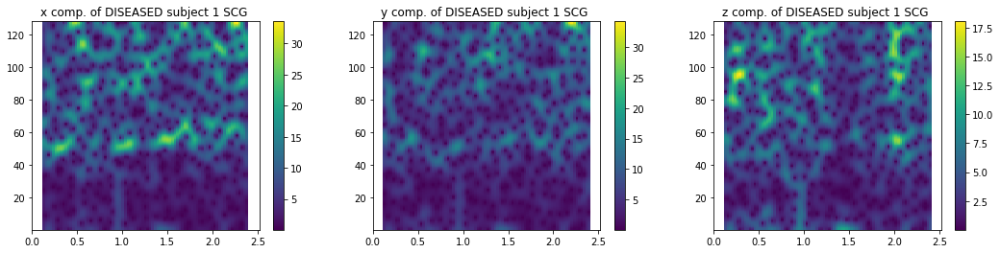

In [31]:
random_scg(dataset1, dataset2 )

### 4- plots of spectogram with specified pair number of loop:

This will allow you to plot pairs in specified numbers. Again seed value should only be used if you want to get same plot at each run.

In [32]:
def random_scg_loop(dataset1, dataset2, seed = None, loop = None):
    np.random.seed(seed)
    
    if loop == 0:
        
        len_of_dt1 = len(dataset1)
        len_of_dt2 = len(dataset2)

        i = np.random.randint(0,len_of_dt1)
        j = np.random.randint(0,len_of_dt2)

        dt1_x = output_spectrogram(dataset1[i][0].data, dataset1[i][0].stats.sampling_rate, wlen=10)
        spectogram_x1, extent_x1, end_x1 = dt1_x[0], dt1_x[1], dt1_x[2]

        dt1_y = output_spectrogram(dataset1[i][1].data, dataset1[i][1].stats.sampling_rate, wlen=10)
        spectogram_y1, extent_y1, end_y1 = dt1_y[0], dt1_y[1], dt1_y[2]

        dt1_z = output_spectrogram(dataset1[i][2].data, dataset1[i][2].stats.sampling_rate, wlen=10)
        spectogram_z1, extent_z1, end_z1 = dt1_z[0], dt1_z[1], dt1_z[2]


        fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(18,4))

        ax1.imshow(spectogram_x1, interpolation="nearest", extent = extent_x1)
        ax1.axis('tight')
        ax1.set_xlim(0, end_x1)
        ax1.title.set_text('x comp. of HEALTY subject {} SCG'.format(i))
        ax1.grid(False)
        fig.colorbar(ax1.images[0], ax = ax1)

        ax2.imshow(spectogram_y1, interpolation="nearest", extent= extent_y1)
        ax2.axis('tight')
        ax2.set_xlim(0, end_y1)
        ax2.title.set_text('y comp. of HEALTY subject {} SCG'.format(i))
        ax2.grid(False)
        fig.colorbar(ax2.images[0], ax = ax2)

        ax3.imshow(spectogram_z1, interpolation="nearest", extent = extent_z1)
        ax3.axis('tight')
        ax3.set_xlim(0, end_z1)
        ax3.title.set_text('z comp. of HEALTY subject {} SCG'.format(i))
        ax3.grid(False)
        fig.colorbar(ax3.images[0], ax = ax3)


        dt2_x = output_spectrogram(dataset2[j][0].data, dataset2[j][0].stats.sampling_rate, wlen=10)
        spectogram_x2, extent_x2, end_x2 = dt2_x[0], dt2_x[1], dt2_x[2]

        dt2_y = output_spectrogram(dataset2[j][1].data, dataset2[j][1].stats.sampling_rate, wlen=10)
        spectogram_y2, extent_y2, end_y2 = dt2_y[0], dt2_y[1], dt2_y[2]

        dt2_z = output_spectrogram(dataset2[j][2].data, dataset2[j][2].stats.sampling_rate, wlen=10)
        spectogram_z2, extent_z2, end_z2 = dt2_z[0], dt2_z[1], dt2_z[2]


        fig, (ax4, ax5, ax6) = plt.subplots(1, 3,  figsize=(18,4))

        ax4.imshow(spectogram_x2, interpolation="nearest", extent= extent_x2)
        ax4.axis('tight')
        ax4.set_xlim(0, end_x2)
        ax4.title.set_text('x comp. of DISEASED subject {} SCG '.format(j))
        ax4.grid(False)
        fig.colorbar(ax4.images[0], ax = ax4)

        ax5.imshow(spectogram_y2, interpolation="nearest", extent= extent_y2)
        ax5.axis('tight')
        ax5.set_xlim(0, end_y2)
        ax5.title.set_text('y comp. of DISEASED subject {} SCG '.format(j))
        ax5.grid(False)
        fig.colorbar(ax5.images[0], ax = ax5)

        ax6.imshow(spectogram_z2, interpolation="nearest", extent= extent_z2)
        ax6.axis('tight')
        ax6.set_xlim(0, end_z2)
        ax6.title.set_text('z comp. of DISEASED subject {} SCG '.format(j))
        ax6.grid(False)
        fig.colorbar(ax6.images[0], ax = ax6)

    else:
        while loop > 0 :
            len_of_dt1 = len(dataset1)
            len_of_dt2 = len(dataset2)

            i = np.random.randint(0,len_of_dt1)
            j = np.random.randint(0,len_of_dt2)

            dt1_x = output_spectrogram(dataset1[i][0].data, dataset1[i][0].stats.sampling_rate, wlen=10)
            spectogram_x1, extent_x1, end_x1 = dt1_x[0], dt1_x[1], dt1_x[2]

            dt1_y = output_spectrogram(dataset1[i][1].data, dataset1[i][1].stats.sampling_rate, wlen=10)
            spectogram_y1, extent_y1, end_y1 = dt1_y[0], dt1_y[1], dt1_y[2]

            dt1_z = output_spectrogram(dataset1[i][2].data, dataset1[i][2].stats.sampling_rate, wlen=10)
            spectogram_z1, extent_z1, end_z1 = dt1_z[0], dt1_z[1], dt1_z[2]


            fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(18,4))

            ax1.imshow(spectogram_x1, interpolation="nearest", extent = extent_x1)
            ax1.axis('tight')
            ax1.set_xlim(0, end_x1)
            ax1.title.set_text('x comp. of HEALTY subject {} SCG'.format(i))
            ax1.grid(False)
            fig.colorbar(ax1.images[0], ax = ax1)

            ax2.imshow(spectogram_y1, interpolation="nearest", extent= extent_y1)
            ax2.axis('tight')
            ax2.set_xlim(0, end_y1)
            ax2.title.set_text('y comp. of HEALTY subject {} SCG'.format(i))
            ax2.grid(False)
            fig.colorbar(ax2.images[0], ax = ax2)

            ax3.imshow(spectogram_z1, interpolation="nearest", extent = extent_z1)
            ax3.axis('tight')
            ax3.set_xlim(0, end_z1)
            ax3.title.set_text('z comp. of HEALTY subject {} SCG'.format(i))
            ax3.grid(False)
            fig.colorbar(ax3.images[0], ax = ax3)


            dt2_x = output_spectrogram(dataset2[j][0].data, dataset2[j][0].stats.sampling_rate, wlen=10)
            spectogram_x2, extent_x2, end_x2 = dt2_x[0], dt2_x[1], dt2_x[2]

            dt2_y = output_spectrogram(dataset2[j][1].data, dataset2[j][1].stats.sampling_rate, wlen=10)
            spectogram_y2, extent_y2, end_y2 = dt2_y[0], dt2_y[1], dt2_y[2]

            dt2_z = output_spectrogram(dataset2[j][2].data, dataset2[j][2].stats.sampling_rate, wlen=10)
            spectogram_z2, extent_z2, end_z2 = dt2_z[0], dt2_z[1], dt2_z[2]


            fig, (ax4, ax5, ax6) = plt.subplots(1, 3,  figsize=(18,4))

            ax4.imshow(spectogram_x2, interpolation="nearest", extent= extent_x2)
            ax4.axis('tight')
            ax4.set_xlim(0, end_x2)
            ax4.title.set_text('x comp. of DISEASED subject {} SCG '.format(j))
            ax4.grid(False)
            fig.colorbar(ax4.images[0], ax = ax4)

            ax5.imshow(spectogram_y2, interpolation="nearest", extent= extent_y2)
            ax5.axis('tight')
            ax5.set_xlim(0, end_y2)
            ax5.title.set_text('y comp. of DISEASED subject {} SCG '.format(j))
            ax5.grid(False)
            fig.colorbar(ax5.images[0], ax = ax5)

            ax6.imshow(spectogram_z2, interpolation="nearest", extent= extent_z2)
            ax6.axis('tight')
            ax6.set_xlim(0, end_z2)
            ax6.title.set_text('z comp. of DISEASED subject {} SCG '.format(j))
            ax6.grid(False)
            fig.colorbar(ax6.images[0], ax = ax6)
            loop = loop -1

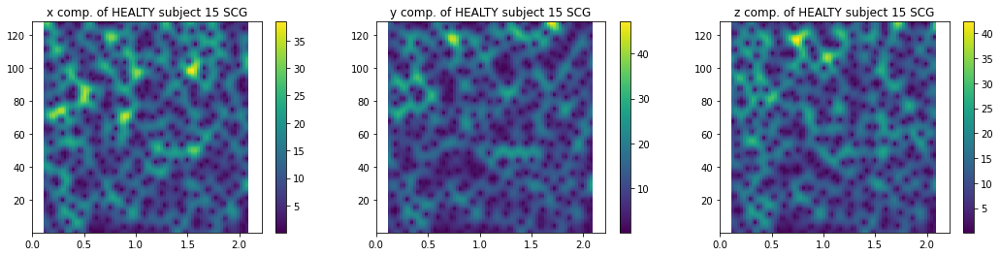

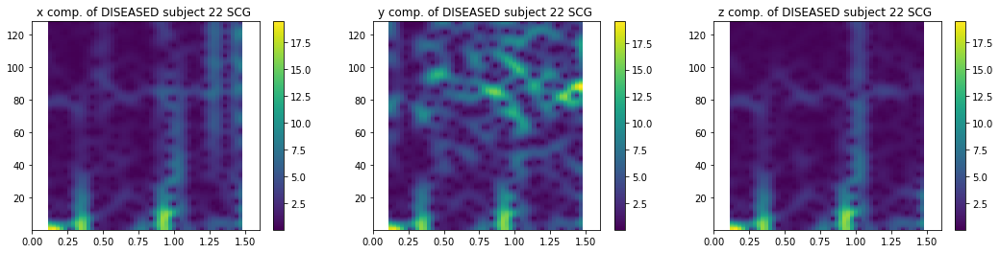

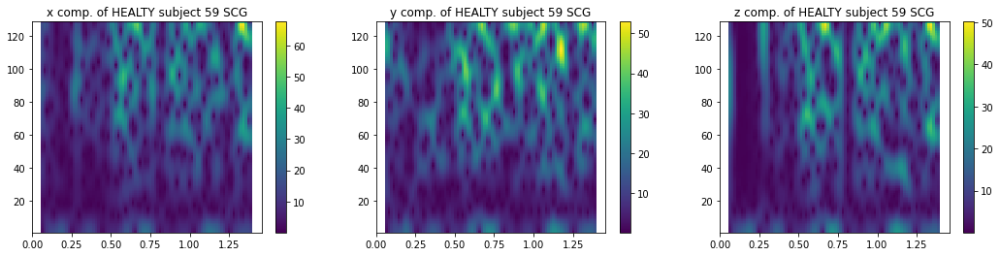

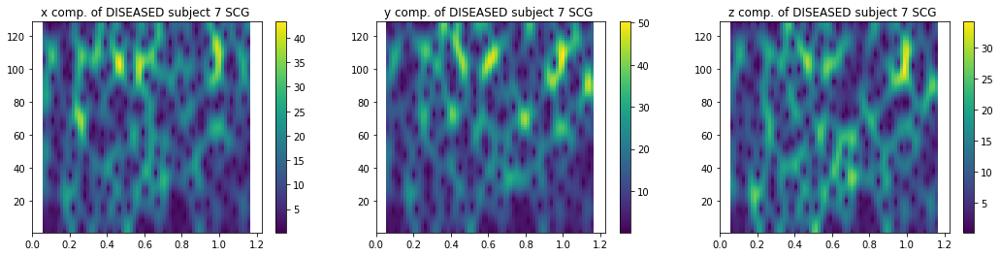

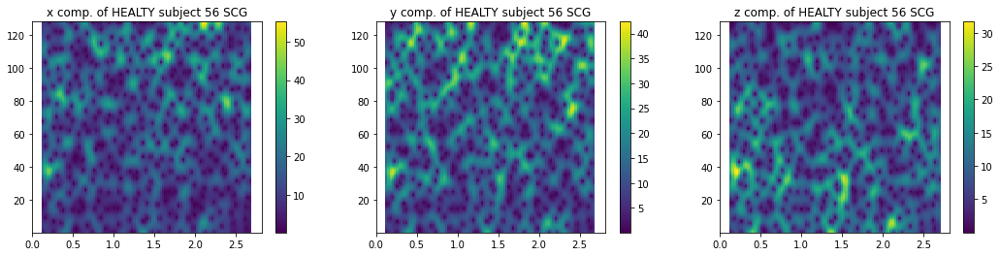

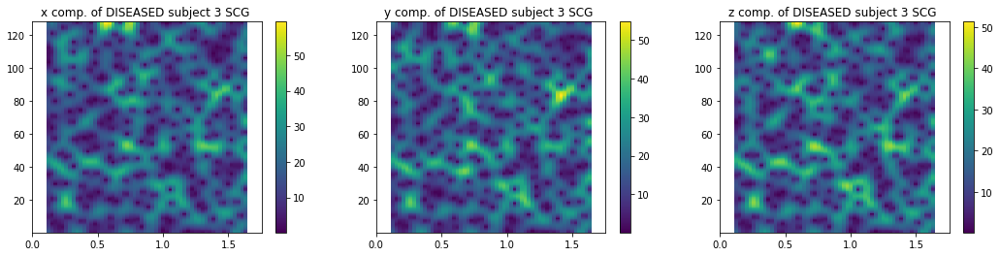

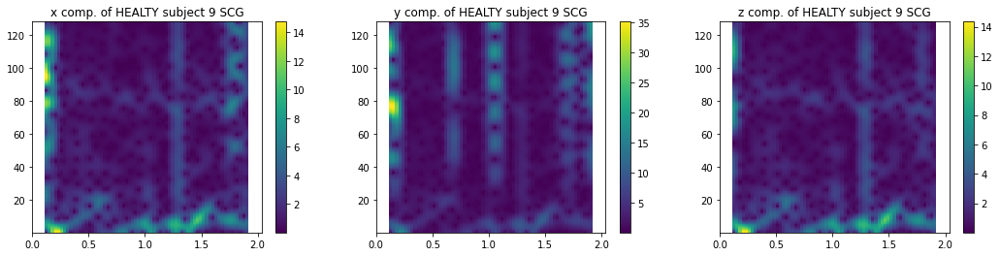

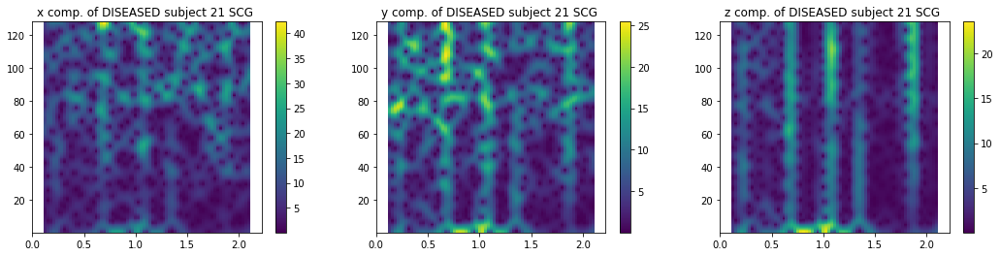

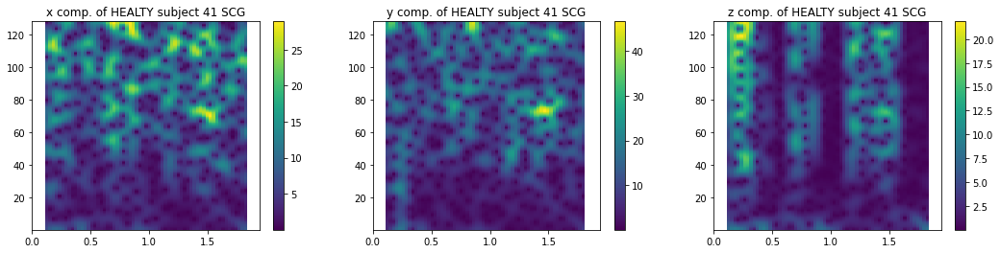

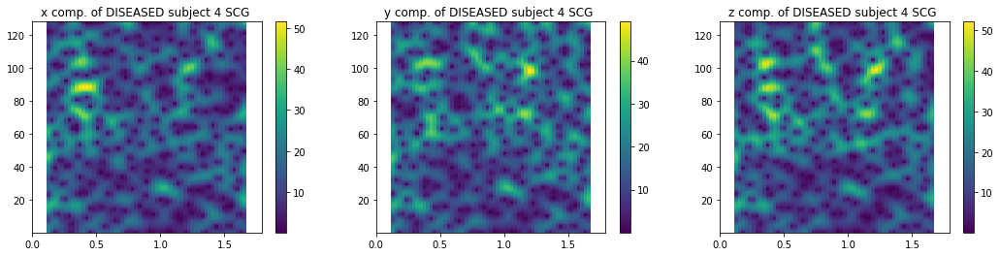

In [33]:
random_scg_loop(dataset1, dataset2, loop = 5)

### 5-Plot all and just spectograms of healty patients

/var/folders/gd/3d6ckpdn4q30skhxnvs_p7b80000gn/T/ipykernel_4755/3869879007.py:15: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(18,4))


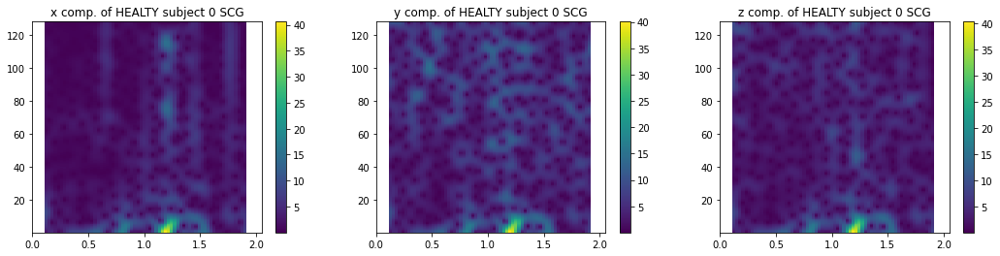

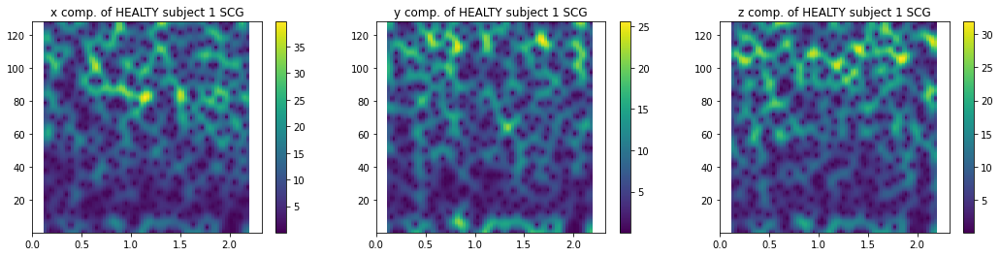

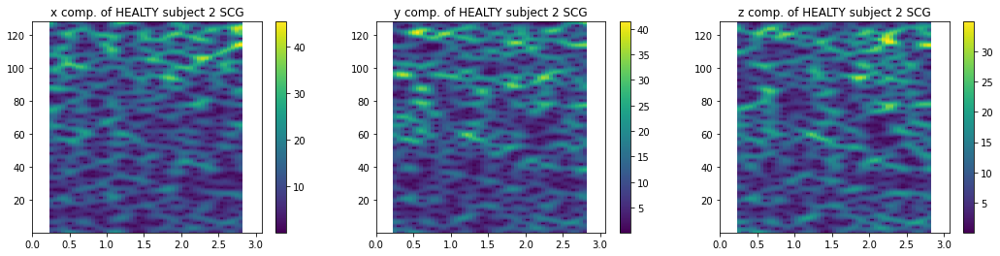

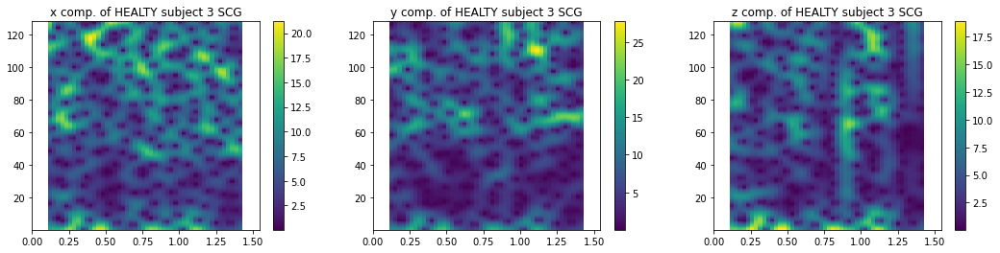

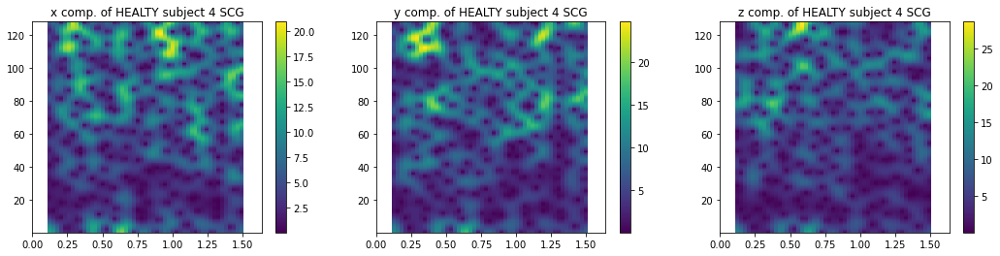

...

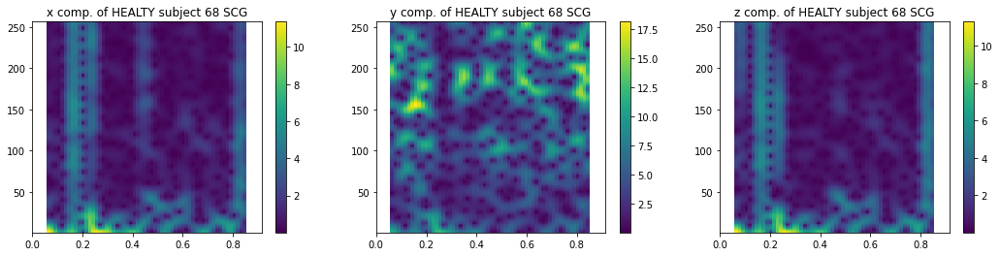

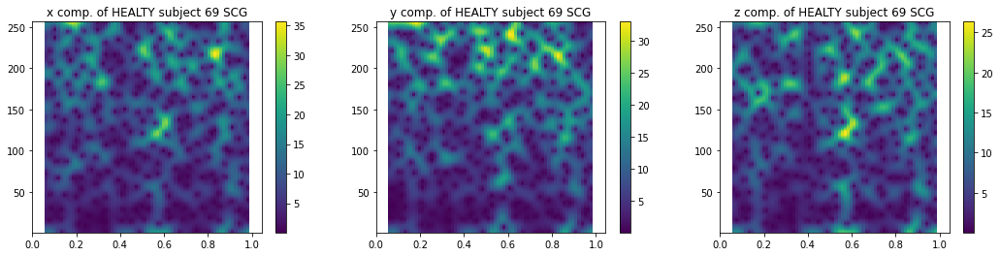

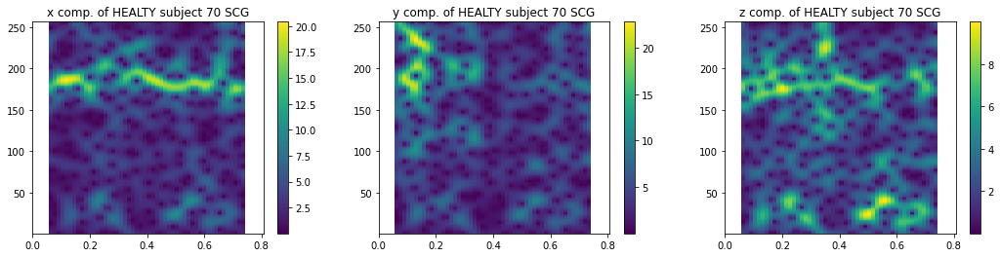

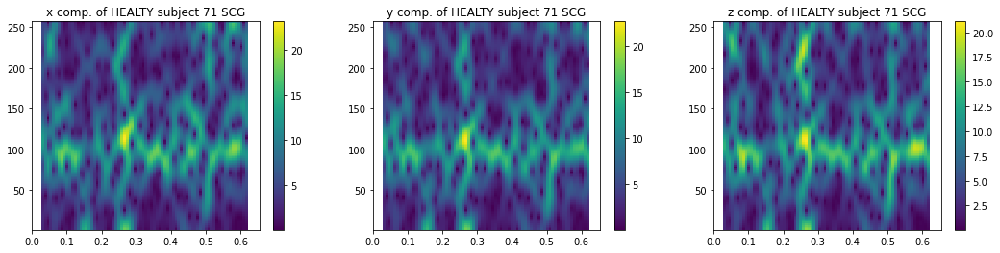

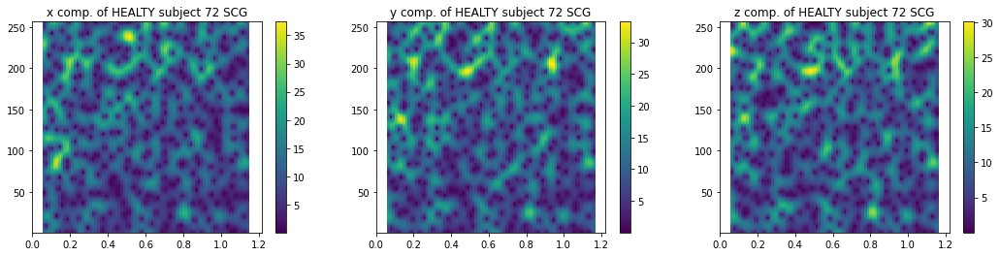

In [34]:
for i in range(len(healty['Patient ID'].index)):

        h_s_x = output_spectrogram(healty_x_slice[i].data, healty_x_slice[i].stats.sampling_rate, wlen=10)[0]
        h_e_x = output_spectrogram(healty_x_slice[i].data, healty_x_slice[i].stats.sampling_rate, wlen=10)[1]
        h_end_x = output_spectrogram(healty_x_slice[i].data, healty_x_slice[i].stats.sampling_rate, wlen=10)[2]

        h_s_y = output_spectrogram(healty_y_slice[i].data, healty_y_slice[i].stats.sampling_rate, wlen=10)[0]
        h_e_y = output_spectrogram(healty_y_slice[i].data, healty_y_slice[i].stats.sampling_rate, wlen=10)[1]
        h_end_y = output_spectrogram(healty_y_slice[i].data, healty_y_slice[i].stats.sampling_rate, wlen=10)[2]
        
        h_s_z = output_spectrogram(healty_z_slice[i].data, healty_z_slice[i].stats.sampling_rate, wlen=10)[0]
        h_e_z = output_spectrogram(healty_z_slice[i].data, healty_z_slice[i].stats.sampling_rate, wlen=10)[1]
        h_end_z = output_spectrogram(healty_z_slice[i].data, healty_z_slice[i].stats.sampling_rate, wlen=10)[2]
        
        fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(18,4))

        ax1.imshow(h_s_x, interpolation="nearest", extent=h_e_x)
        ax1.axis('tight')
        ax1.set_xlim(0, h_end_x)
        ax1.title.set_text('x comp. of HEALTY subject {} SCG'.format(i))
        ax1.grid(False)
        fig.colorbar(ax1.images[0], ax = ax1)
        
        ax2.imshow(h_s_y, interpolation="nearest", extent=h_e_y)
        ax2.axis('tight')
        ax2.set_xlim(0, h_end_y)
        ax2.title.set_text('y comp. of HEALTY subject {} SCG'.format(i))
        ax2.grid(False)
        fig.colorbar(ax2.images[0], ax = ax2)
        
        ax3.imshow(h_s_z, interpolation="nearest", extent=h_e_z)
        ax3.axis('tight')
        ax3.set_xlim(0, h_end_z)
        ax3.title.set_text('z comp. of HEALTY subject {} SCG'.format(i))
        ax3.grid(False)
        fig.colorbar(ax3.images[0], ax = ax3)

### 6- plot all and just spectograms of diseased subject:


/var/folders/gd/3d6ckpdn4q30skhxnvs_p7b80000gn/T/ipykernel_4755/58500402.py:15: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, (ax4, ax5, ax6) = plt.subplots(1, 3,  figsize=(18,4))


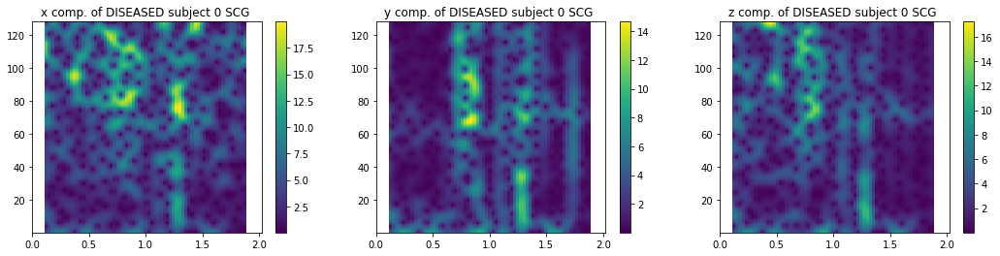

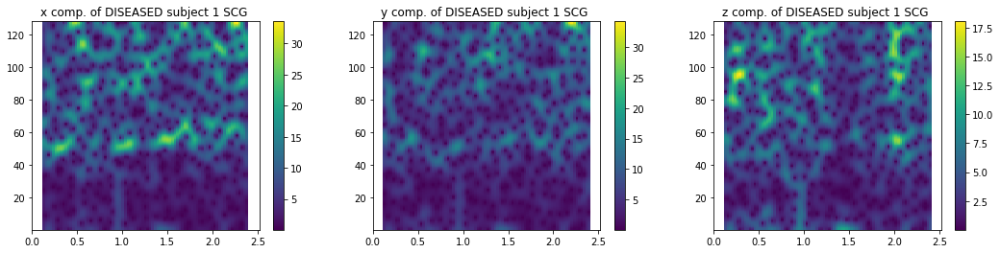

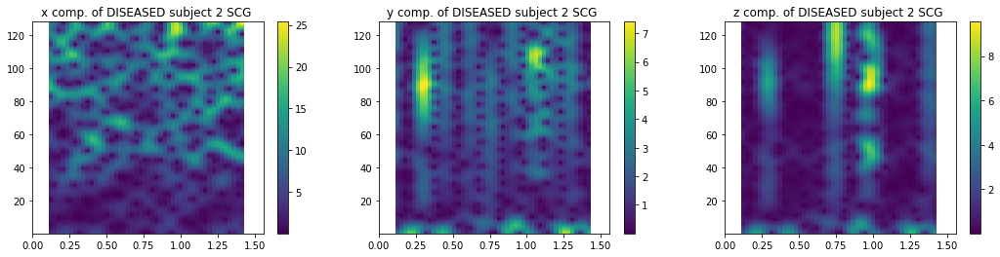

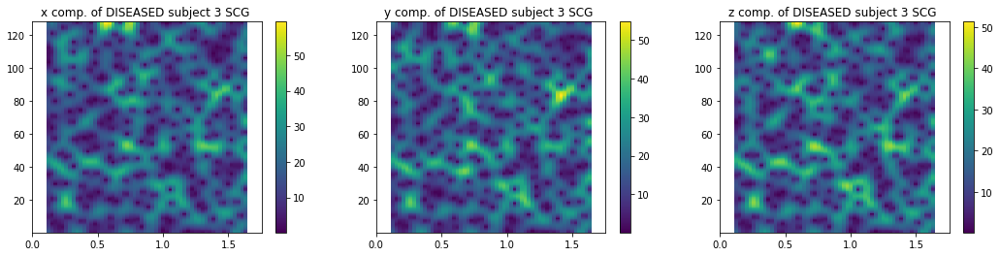

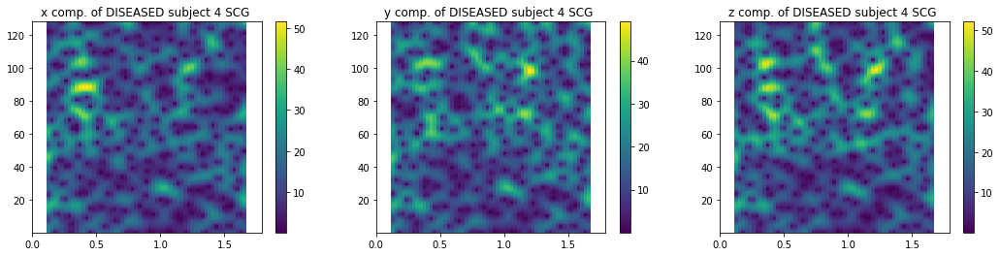

...

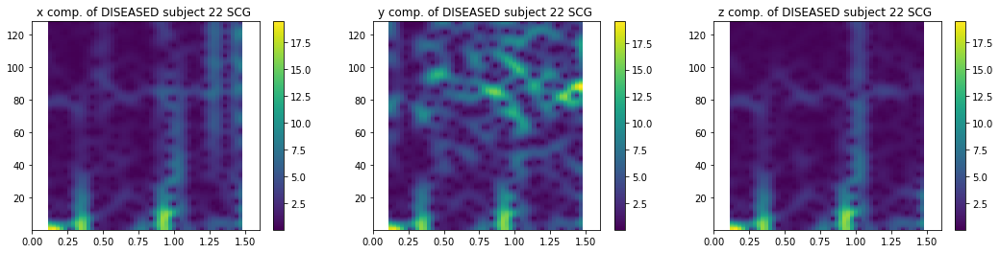

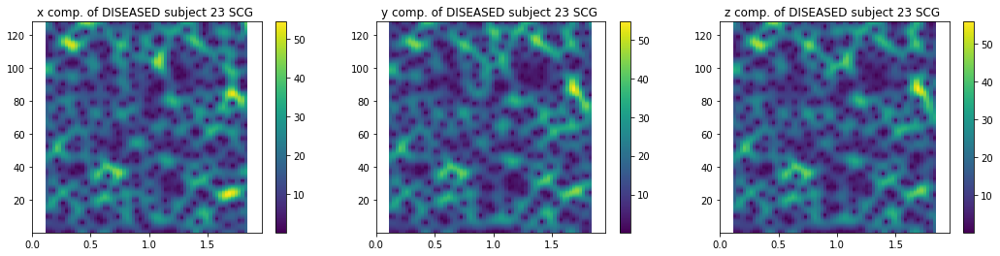

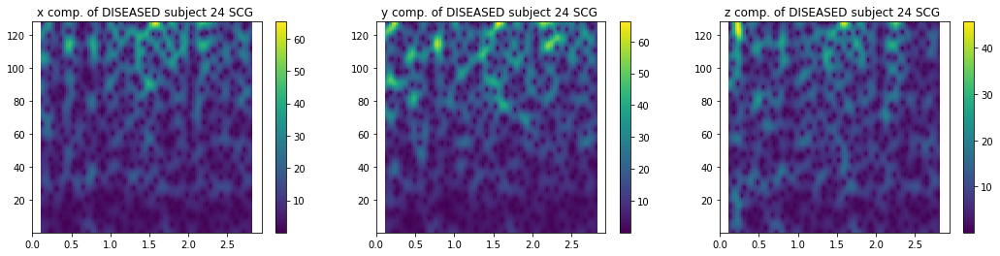

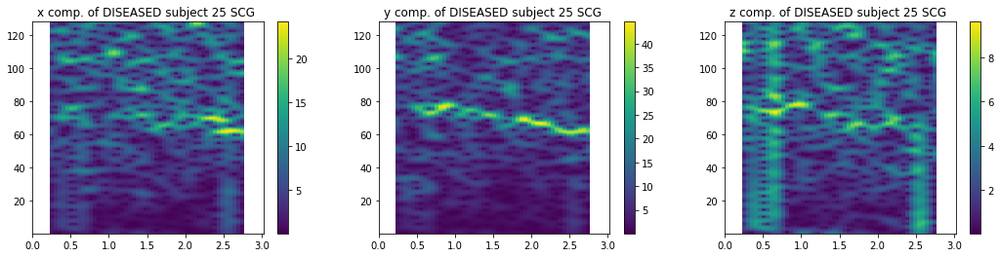

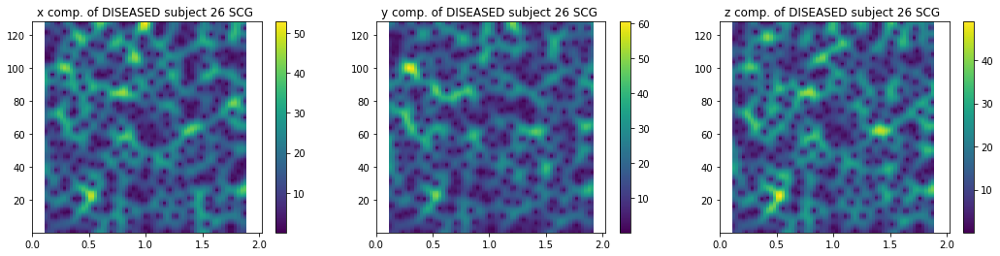

In [35]:
for j in range(len(diseased['Patient ID'].index)):
        d_s_x = output_spectrogram(diseased_x_slice[j].data, diseased_x_slice[j].stats.sampling_rate, wlen=10)[0]
        d_e_x = output_spectrogram(diseased_x_slice[j].data, diseased_x_slice[j].stats.sampling_rate, wlen=10)[1]
        d_end_x = output_spectrogram(diseased_x_slice[j].data, diseased_x_slice[j].stats.sampling_rate, wlen=10)[2]
        
        d_s_y = output_spectrogram(diseased_y_slice[j].data, diseased_y_slice[j].stats.sampling_rate, wlen=10)[0]
        d_e_y = output_spectrogram(diseased_y_slice[j].data, diseased_y_slice[j].stats.sampling_rate, wlen=10)[1]
        d_end_y = output_spectrogram(diseased_y_slice[j].data, diseased_y_slice[j].stats.sampling_rate, wlen=10)[2]
        
        d_s_z = output_spectrogram(diseased_z_slice[j].data, diseased_z_slice[j].stats.sampling_rate, wlen=10)[0]
        d_e_z = output_spectrogram(diseased_z_slice[j].data, diseased_z_slice[j].stats.sampling_rate, wlen=10)[1]
        d_end_z = output_spectrogram(diseased_z_slice[j].data, diseased_z_slice[j].stats.sampling_rate, wlen=10)[2]
        
        
        fig, (ax4, ax5, ax6) = plt.subplots(1, 3,  figsize=(18,4))

        ax4.imshow(d_s_x, interpolation="nearest", extent=d_e_x)
        ax4.axis('tight')
        ax4.set_xlim(0, d_end_x)
        ax4.title.set_text('x comp. of DISEASED subject {} SCG '.format(j))
        ax4.grid(False)
        fig.colorbar(ax4.images[0], ax = ax4)
        
        ax5.imshow(d_s_y, interpolation="nearest", extent=d_e_y)
        ax5.axis('tight')
        ax5.set_xlim(0, d_end_y)
        ax5.title.set_text('y comp. of DISEASED subject {} SCG '.format(j))
        ax5.grid(False)
        fig.colorbar(ax5.images[0], ax = ax5)
    
        ax6.imshow(d_s_z, interpolation="nearest", extent=d_e_z)
        ax6.axis('tight')
        ax6.set_xlim(0, d_end_z)
        ax6.title.set_text('z comp. of DISEASED subject {} SCG '.format(j))
        ax6.grid(False)
        fig.colorbar(ax6.images[0], ax = ax6)
    